In [ ]:
!pip3 install tensorflow==2.8
!pip3 install lime
!pip3 install shap==0.40.0
!pip3 install -q tfimm
!pip3 install -q timm==0.6.13
!pip3 install tensorflow-addons

In [ ]:
from numba import cuda

device = cuda.get_current_device()
device.reset()

In [2]:
import sys, os, glob, pathlib, shap, warnings, tfimm, time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_image
from skimage.segmentation import mark_boundaries
from skimage.io import imread, imsave
from skimage.transform import resize

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, roc_auc_score

warnings.filterwarnings(action="ignore", message="^internal gelsd")

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, Model, Input
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, KLDivergence
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.data.experimental import cardinality

from tensorflow_addons.optimizers import AdamW

from google.colab import drive
drive.mount('/content/drive')

sys.path.insert(0,'/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/utils')
from gradCam import read_and_transform_img, make_gradcam_heatmap_ViT, display_gradcam
from distillation_ViT import DeiT, ViTDistilled
from distillation import Distiller
from student_vit import StudentViT
from occlusion_maps import OcclusionMaps
from rise import RISE

Mounted at /content/drive


<h1>Load Dataset</h1>

In [3]:
!unzip -q '/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/datasets/dataset_CD_UC_v3.zip'

In [4]:
data_dir = pathlib.Path('/content/dataset_CD_UC')

# Input size initial
batch_size = 32
IMG_SIZE = (224, 224)

# Distillation
BASE_LR = 1e-5
WEIGHT_DECAY = 0.0001
lr_scaled = (BASE_LR / 512) * batch_size

train_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.7,
  subset="training",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_batches = cardinality(val_ds)
test_ds = val_ds.take((2*val_batches) // 3)    #Take 20% for test
val_ds = val_ds.skip((2*val_batches) // 3)   #Take 10% for validation

class_names = train_ds.class_names

print(class_names)

Found 2714 files belonging to 2 classes.
Using 815 files for training.
Found 2714 files belonging to 2 classes.
Using 814 files for validation.
['crohn-disease', 'ulcerative-colitis']


Found 2714 files belonging to 2 classes.


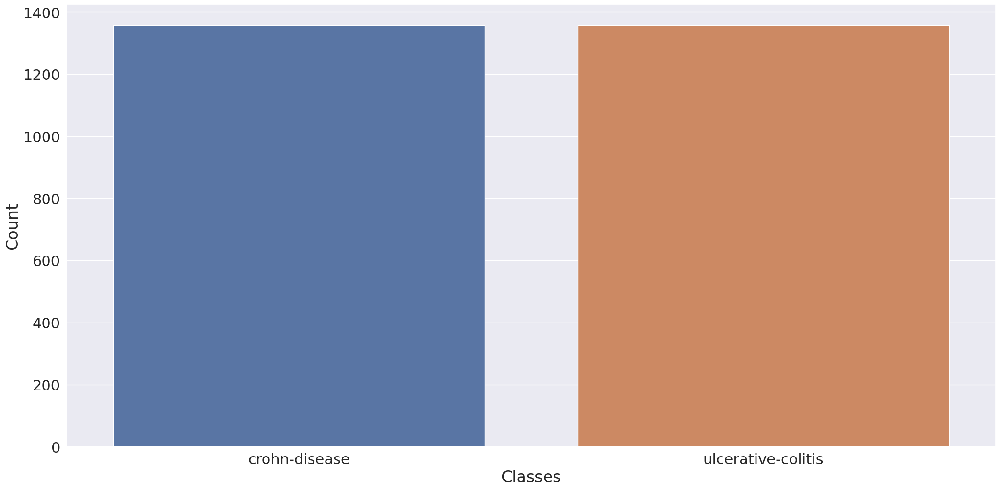

In [ ]:
def class_distribution(dataset):
    class_values = []
    total_batches = dataset.__len__().numpy()
    for batch, element in enumerate(dataset.as_numpy_iterator()):
        if batch+1 == total_batches:
            for i in range(len(element[1])):
                class_values.append(class_names[int(element[1][i])])
        else:
            for i in range(batch_size):
                class_values.append(class_names[int(element[1][i])])

    class_n, frequency = np.unique(np.array(class_values), return_counts=True)
    count = pd.DataFrame(columns=["Classes","Count"])
    count["Classes"] = class_n
    count["Count"] = frequency
    return count, class_values

dataset1 = image_dataset_from_directory(data_dir)

df_class_dist, class_df_values_val = class_distribution(dataset1)
plt.figure(figsize=(25, 12))
sns.set(font_scale=2.0)
sns.barplot(data=df_class_dist, y="Count" ,x="Classes");
plt.show()

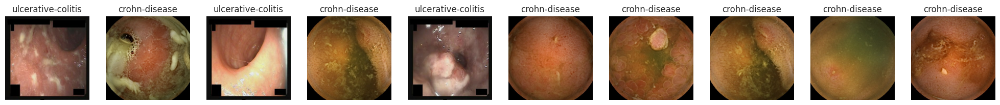

In [ ]:
plt.figure(figsize=(25, 15))
for images, labels in train_ds.take(1):
    for i in range(10):
        ax = plt.subplot(2, 10, i + 1)
        sns.set(font_scale=1.0)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

<h1>Classificiation</h1>

In [5]:
data_augmentation = Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.15),
  layers.RandomZoom(-.2,-.3)
])

In [6]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)
sns.set(font_scale=1.0)

In [7]:
images, labels = tuple(zip(*val_ds))

true_images = np.concatenate(images)
true_labels = np.concatenate(labels)

<h1>Student model</h1>

In [8]:
inputs = Input(shape=IMG_SIZE+(3,))
outputs = ViTDistilled().call(inputs)
student_model_1 = Model(inputs, outputs)

student_model_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.compat.v1.shape (TFOpLambda  (4,)                0           ['input_1[0][0]']                
 )                                                                                                
                                                                                                  
 tf.__operators__.getitem (Slic  ()                  0           ['tf.compat.v1.shape[0][0]']     
 ingOpLambda)                                                                                 

In [9]:
inputs = Input(shape=IMG_SIZE+(3,))
x = data_augmentation(inputs)
x = layers.Rescaling(1./255)(x)
outputs = StudentViT(16).call(x)
student_model_2 = Model(inputs, outputs)

student_model_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_6[0][0]']                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['sequential[0][0]']             
                                                                                                  
 patches (Patches)              (None, None, 768)    0           ['rescaling[0][0]']        

<h1>Images to Interpretability</h1>

In [10]:
dir = pathlib.Path('/content/test')
interpretability_data = image_dataset_from_directory(dir, image_size=IMG_SIZE, batch_size=batch_size)
print(interpretability_data.class_names)

images_exp, labels_exp = tuple(zip(*interpretability_data))

image_interpretability_3 = np.concatenate(images_exp)
labels_interpretability_3 = np.concatenate(labels_exp)

Found 6 files belonging to 2 classes.
['crohn-disease', 'ulcerative-colitis']


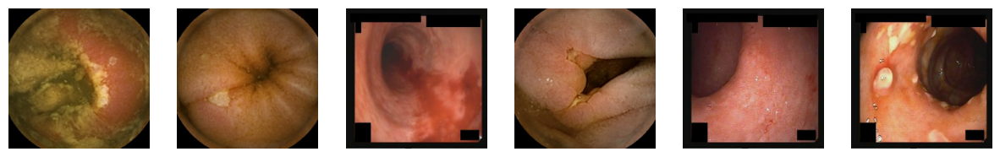

In [11]:
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  ax.imshow(img_array[0].astype(np.uint8))
  ax.axis('off')

In [12]:
print('*** Ground truth ***\n')
for val in labels_interpretability_3:
  if val == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

*** Ground truth ***

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis


# ViT_B/32

In [ ]:
vit_model = tfimm.create_model("vit_base_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_preprocessing = tfimm.create_preprocessing("vit_base_patch32_224_in21k")

inputs = Input(shape=(224, 224,3))
x = data_augmentation(inputs)
x = vit_model_preprocessing(x)
x = vit_model.call(x)
outputs = layers.Dense(len(class_names))(x)
model_vit_b32 = Model(inputs, outputs)

In [ ]:
model_vit_b32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history = model_vit_b32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
26/26 [==============================] - 29s 548ms/step - loss: 0.2182 - accuracy: 0.9141 - val_loss: 0.0165 - val_accuracy: 0.9982
Epoch 2/200
26/26 [==============================] - 12s 457ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0070 - val_accuracy: 0.9982
Epoch 3/200
26/26 [==============================] - 12s 445ms/step - loss: 4.7396e-04 - accuracy: 1.0000 - val_loss: 0.0079 - val_accuracy: 0.9982
Epoch 4/200
26/26 [==============================] - 13s 464ms/step - loss: 6.7840e-04 - accuracy: 1.0000 - val_loss: 0.0114 - val_accuracy: 0.9963
Epoch 5/200
26/26 [==============================] - 12s 446ms/step - loss: 3.6252e-04 - accuracy: 1.0000 - val_loss: 0.0097 - val_accuracy: 0.9963
Epoch 6/200
26/26 [==============================] - 12s 471ms/step - loss: 3.1133e-04 - accuracy: 1.0000 - val_loss: 0.0049 - val_accuracy: 0.9982


<Axes: >

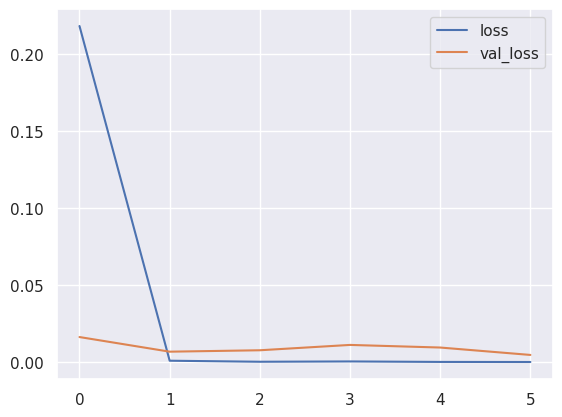

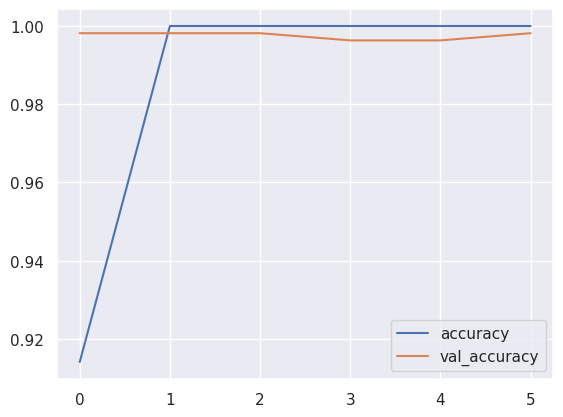

In [ ]:
model_history = pd.DataFrame(history.history)
model_history.loc[:, ['loss', 'val_loss']].plot()
model_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history['val_loss'].mean()))

Accuracy for Train: 0.9857
Loss for Train: 0.0369
Accuracy for Test: 0.9975
Loss for Test: 0.0096


In [ ]:
start = time.time()
predict_labels_ = model_vit_b32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels = np.argmax(model_vit_b32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels)))

Accuracy: 1.0000
Loss: 0.0040
Inference Time: 4.88s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


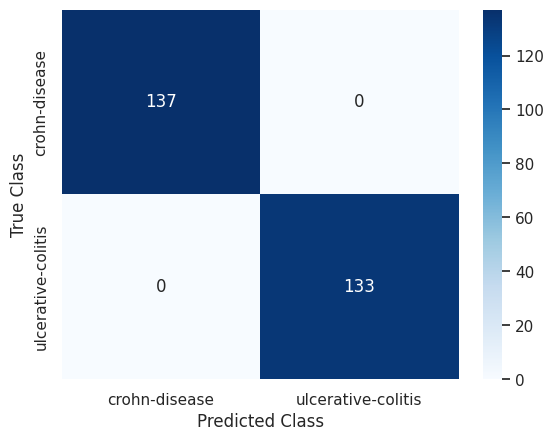

In [ ]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h2>Knowledge Distillation</h2>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_b32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, batch_size=batch_size, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
26/26 [==============================] - 16s 227ms/step - accuracy: 0.6663 - student_loss: 0.9266 - distillation_loss: 8.2340 - val_accuracy: 0.9743 - val_student_loss: 0.0696
Epoch 2/100
26/26 [==============================] - 5s 183ms/step - accuracy: 0.8883 - student_loss: 0.3185 - distillation_loss: 3.8796 - val_accuracy: 0.9669 - val_student_loss: 0.0480
Epoch 3/100
26/26 [==============================] - 6s 228ms/step - accuracy: 0.9374 - student_loss: 0.1898 - distillation_loss: 2.8671 - val_accuracy: 0.9798 - val_student_loss: 0.1686
Epoch 4/100
26/26 [==============================] - 5s 180ms/step - accuracy: 0.9301 - student_loss: 0.1954 - distillation_loss: 2.9868 - val_accuracy: 0.9835 - val_student_loss: 0.0470
Epoch 5/100
26/26 [==============================] - 5s 185ms/step - accuracy: 0.9571 - student_loss: 0.1367 - distillation_loss: 2.3537 - val_accuracy: 0.9908 - val_student_loss: 0.0069
Epoch 6/100
26/26 [==============================] - 6s 225ms/st

<Axes: >

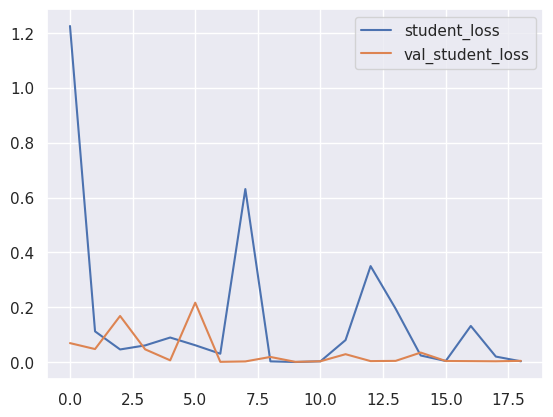

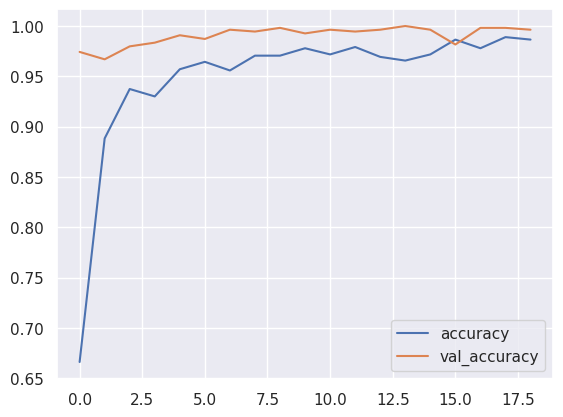

In [ ]:
distiller_history_2 = pd.DataFrame(distillation_history.history)
distiller_history_2.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history_2.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history_2['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history_2['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history_2['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history_2['val_student_loss'].mean()))

Accuracy for Train: 0.9482
Loss for Train: 0.1620
Accuracy for Test: 0.9906
Loss for Test: 0.0356


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9926
Loss: 0.0151
Inference Time: 1.77s
Precision: 0.9852
Recall: 1.0000
F1-Score: 0.9925
AUC: 0.9927
MCC: 0.9853


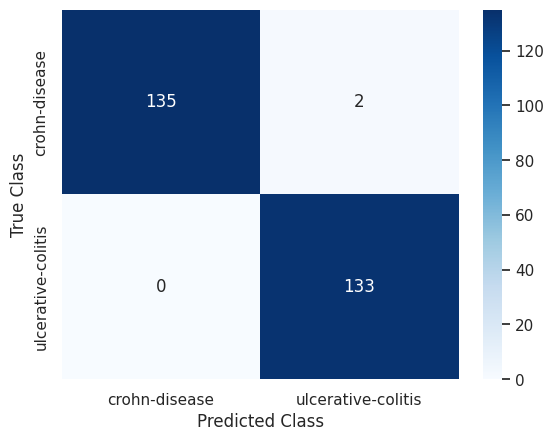

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
26/26 [==============================] - 17s 211ms/step - accuracy: 0.5092 - student_loss: 0.7519 - distillation_loss: 0.9632 - val_accuracy: 0.9283 - val_student_loss: 0.6030 - val_distillation_loss: 0.0000e+00
Epoch 2/100
26/26 [==============================] - 6s 205ms/step - accuracy: 0.6454 - student_loss: 0.6567 - distillation_loss: 0.7322 - val_accuracy: 0.9338 - val_student_loss: 0.5143 - val_distillation_loss: 0.0000e+00
Epoch 3/100
26/26 [==============================] - 6s 224ms/step - accuracy: 0.7117 - student_loss: 0.5897 - distillation_loss: 0.6707 - val_accuracy: 0.9706 - val_student_loss: 0.4145 - val_distillation_loss: 0.0000e+00
Epoch 4/100
26/26 [==============================] - 5s 191ms/step - accuracy: 0.7681 - student_loss: 0.5317 - distillation_loss: 0.5886 - val_accuracy: 0.9596 - val_student_loss: 0.3184 - val_distillation_loss: 0.0000e+00
Epoch 5/100
26/26 [==============================] - 6s 207ms/step - accuracy: 0.8601 - student_loss: 0.399

<Axes: >

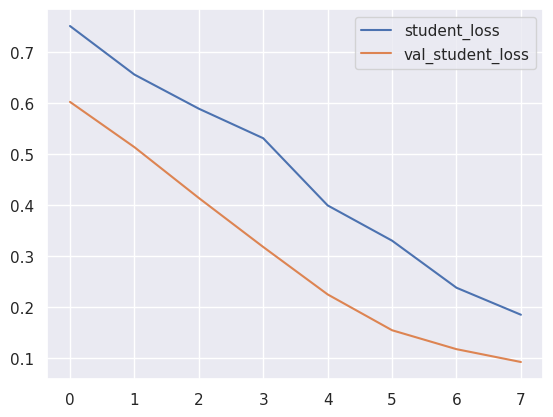

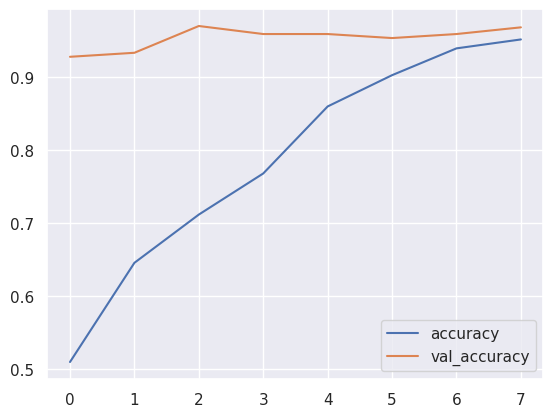

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7862
Loss for Train: 0.4606
Accuracy for Test: 0.9543
Loss for Test: 0.3051


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9704
Loss: 0.0734
Inference Time: 1.06s
Precision: 0.9630
Recall: 0.9774
F1-Score: 0.9701
AUC: 0.9705
MCC: 0.9408


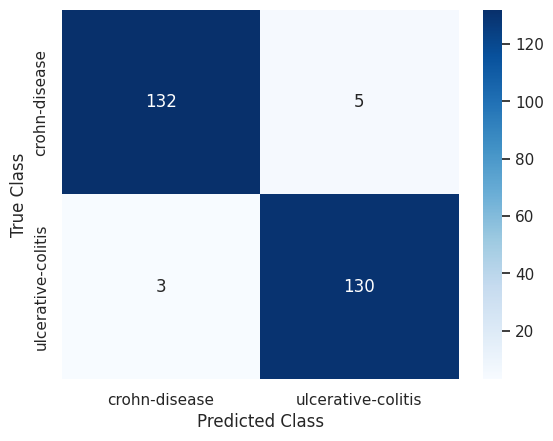

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

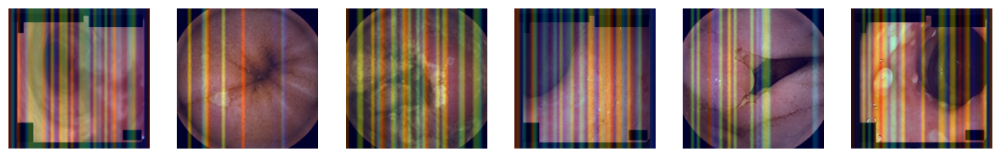

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b32.layers[-1].activation = None

  preds = model_vit_b32.predict(img_array)
  heatmap = make_gradcam_heatmap_ViT(img_array, model_vit_b32, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,50))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

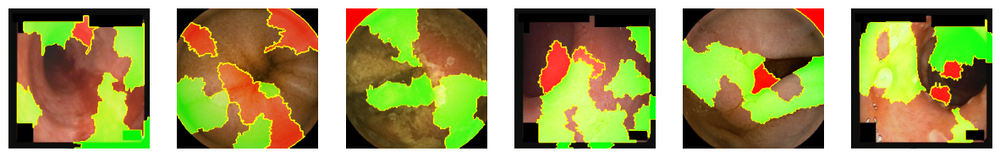

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


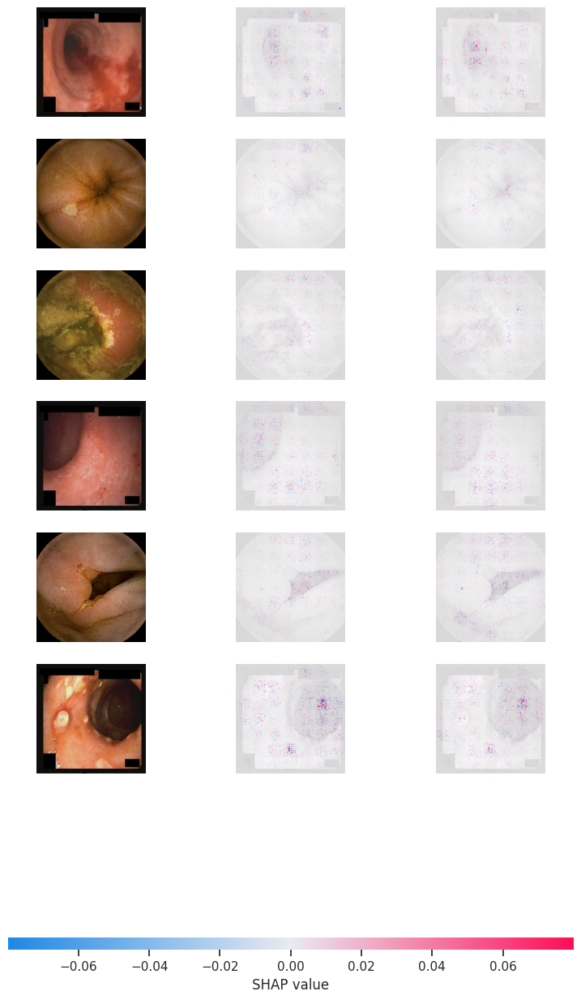

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b32, images_train_1).shap_values(image_interpretability_3)
shap.image_plot(shap_values, image_interpretability_3)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:04<00:00, 240.24it/s]


Explaining: 100%|██████████| 32/32 [00:05<00:00,  5.89it/s]


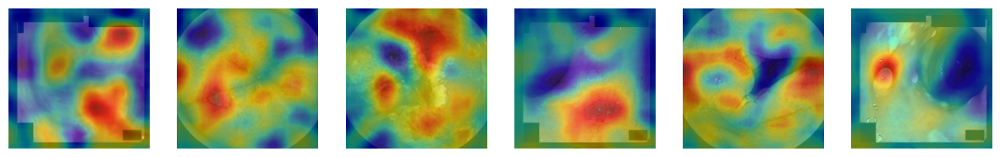

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

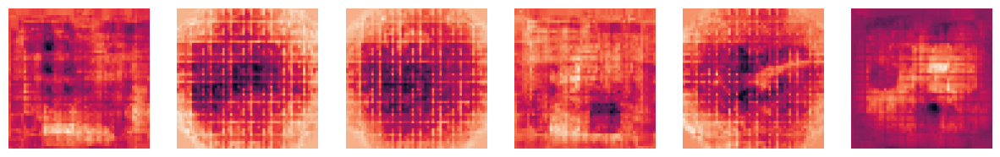

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_b32, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

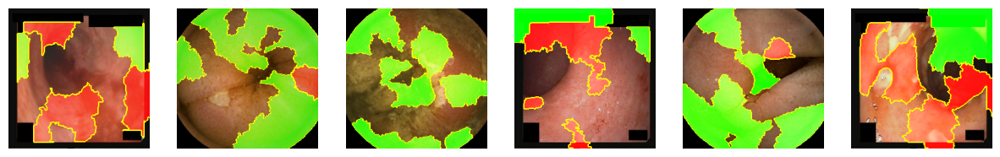

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 432.01it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.53it/s]


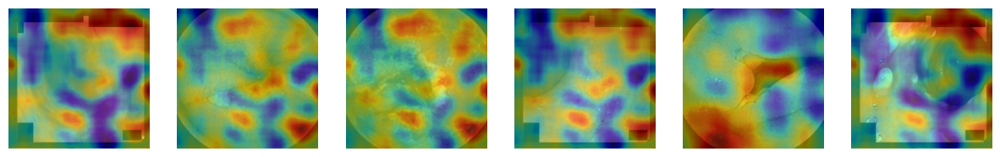

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

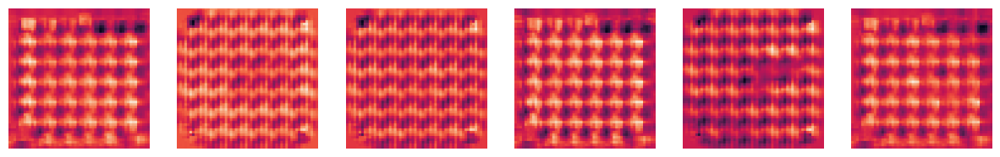

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h2>Interpretability of Second Student</h2>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

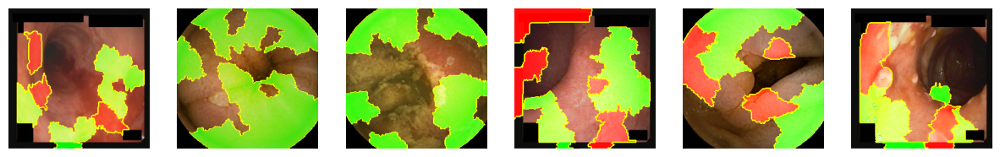

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.64it/s]


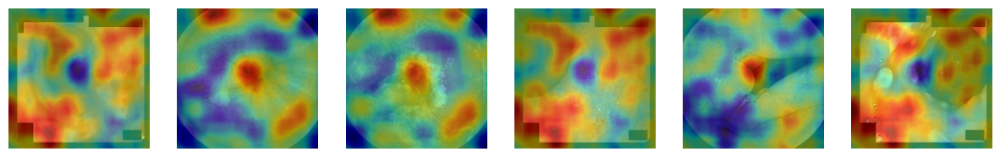

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

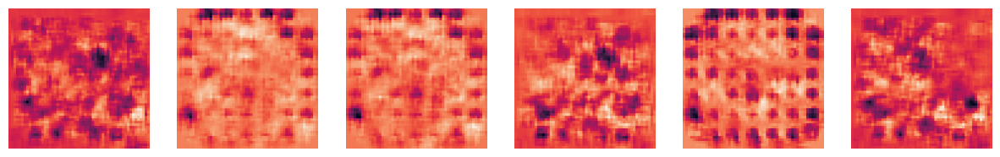

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/32

In [ ]:
vit_model_s32 = tfimm.create_model("vit_small_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_s32_preprocessing = tfimm.create_preprocessing("vit_small_patch32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s32_preprocessing(x)
x = vit_model_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s32 = Model(inputs, outputs)

In [ ]:
model_vit_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s32 = model_vit_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
26/26 [==============================] - 23s 350ms/step - loss: 0.0585 - accuracy: 0.9730 - val_loss: 0.0023 - val_accuracy: 0.9982
Epoch 2/200
26/26 [==============================] - 5s 190ms/step - loss: 3.6599e-04 - accuracy: 1.0000 - val_loss: 0.0014 - val_accuracy: 1.0000
Epoch 3/200
26/26 [==============================] - 5s 193ms/step - loss: 0.0034 - accuracy: 0.9988 - val_loss: 0.0031 - val_accuracy: 0.9982
Epoch 4/200
26/26 [==============================] - 7s 244ms/step - loss: 4.3739e-04 - accuracy: 1.0000 - val_loss: 0.0038 - val_accuracy: 0.9982
Epoch 5/200
26/26 [==============================] - 5s 189ms/step - loss: 1.7795e-04 - accuracy: 1.0000 - val_loss: 6.3251e-05 - val_accuracy: 1.0000
Epoch 6/200
26/26 [==============================] - 7s 238ms/step - loss: 2.7204e-04 - accuracy: 1.0000 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 7/200
26/26 [==============================] - 5s 190ms/step - loss: 4.2893e-05 - accuracy: 1.0000 - val_loss: 6.00

<Axes: >

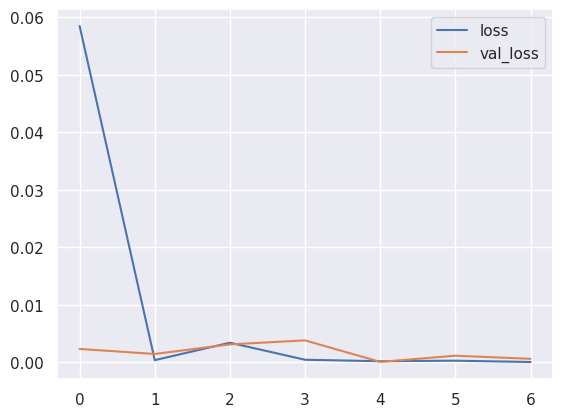

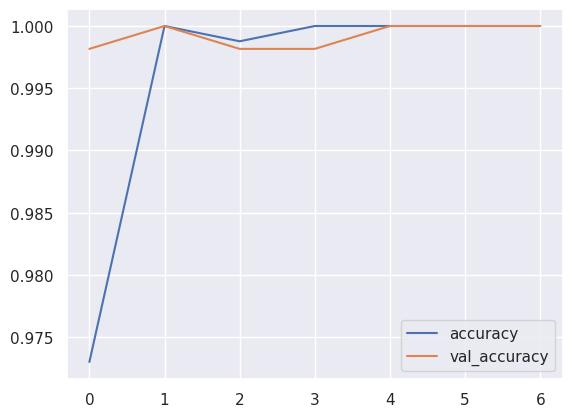

In [ ]:
model_history_s32 = pd.DataFrame(history_s32.history)
model_history_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s32['val_loss'].mean()))

Accuracy for Train: 0.9960
Loss for Train: 0.0090
Accuracy for Test: 0.9992
Loss for Test: 0.0018


In [ ]:
start = time.time()
predict_labels_ = model_vit_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s32 = np.argmax(model_vit_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s32)))

Accuracy: 1.0000
Loss: 0.0012
Inference Time: 2.85s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


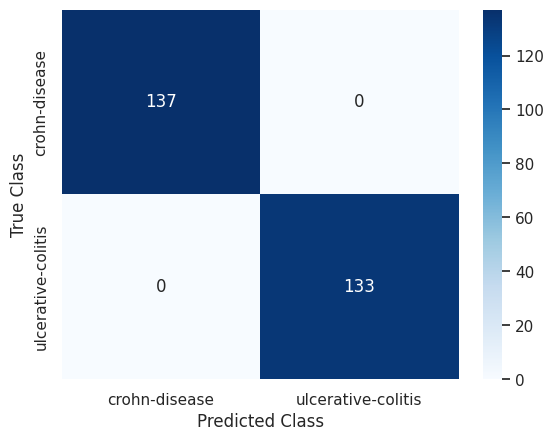

In [ ]:
conf_matrix_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
26/26 [==============================] - 15s 148ms/step - accuracy: 0.5362 - student_loss: 1.3087 - distillation_loss: 21.8950 - val_accuracy: 0.9853 - val_student_loss: 0.2051
Epoch 2/100
26/26 [==============================] - 5s 195ms/step - accuracy: 0.7607 - student_loss: 0.5814 - distillation_loss: 15.4693 - val_accuracy: 0.9651 - val_student_loss: 0.1622
Epoch 3/100
26/26 [==============================] - 4s 127ms/step - accuracy: 0.9423 - student_loss: 0.1969 - distillation_loss: 5.5919 - val_accuracy: 0.9779 - val_student_loss: 1.3586e-04
Epoch 4/100
26/26 [==============================] - 3s 122ms/step - accuracy: 0.9571 - student_loss: 0.1647 - distillation_loss: 4.7811 - val_accuracy: 0.9853 - val_student_loss: 0.0021
Epoch 5/100
26/26 [==============================] - 7s 244ms/step - accuracy: 0.9558 - student_loss: 0.1694 - distillation_loss: 4.4534 - val_accuracy: 0.9853 - val_student_loss: 0.0324
Epoch 6/100
26/26 [==============================] - 6s 21

<Axes: >

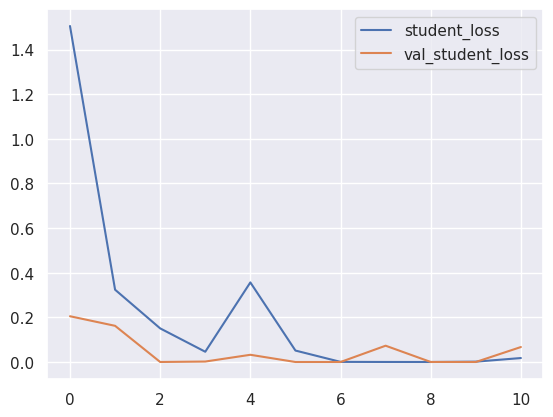

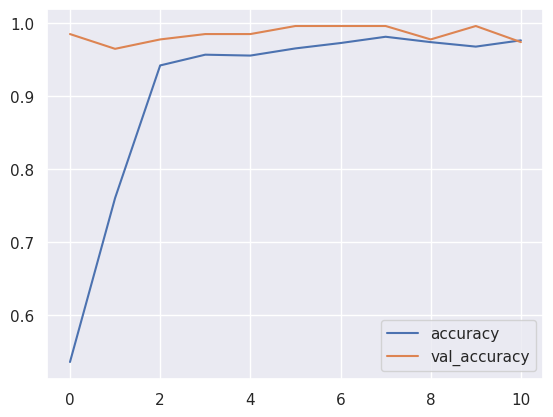

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9083
Loss for Train: 0.2232
Accuracy for Test: 0.9851
Loss for Test: 0.0493


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9667
Loss: 0.1389
Inference Time: 1.78s
Precision: 0.9366
Recall: 1.0000
F1-Score: 0.9673
AUC: 0.9672
MCC: 0.9355


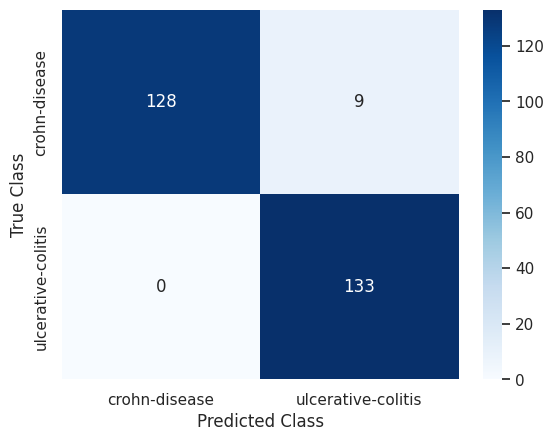

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
52/52 [==============================] - 27s 355ms/step - accuracy: 0.6534 - student_loss: 0.7924 - distillation_loss: 0.6404 - val_accuracy: 0.8787 - val_student_loss: 0.4265 - val_distillation_loss: 0.0000e+00
Epoch 2/100
52/52 [==============================] - 18s 336ms/step - accuracy: 0.7975 - student_loss: 0.5670 - distillation_loss: 0.4802 - val_accuracy: 0.9154 - val_student_loss: 0.2635 - val_distillation_loss: 0.0000e+00
Epoch 3/100
52/52 [==============================] - 18s 349ms/step - accuracy: 0.8822 - student_loss: 0.4224 - distillation_loss: 0.3324 - val_accuracy: 0.9136 - val_student_loss: 0.2449 - val_distillation_loss: 0.0000e+00
Epoch 4/100
52/52 [==============================] - 17s 327ms/step - accuracy: 0.9086 - student_loss: 0.3042 - distillation_loss: 0.2718 - val_accuracy: 0.9320 - val_student_loss: 0.1694 - val_distillation_loss: 0.0000e+00
Epoch 5/100
52/52 [==============================] - 17s 324ms/step - accuracy: 0.9184 - student_loss: 0

<Axes: >

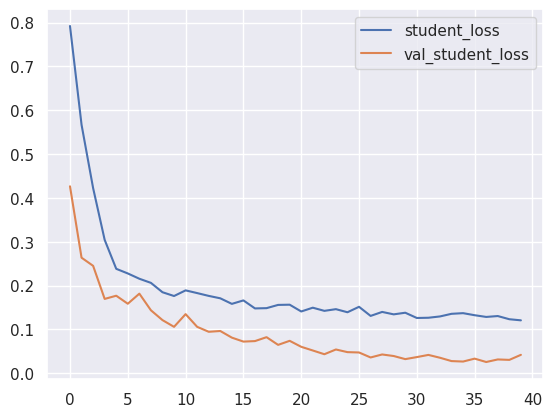

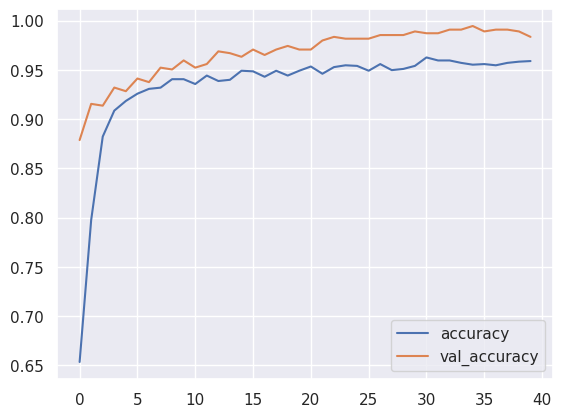

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9342
Loss for Train: 0.1921
Accuracy for Test: 0.9671
Loss for Test: 0.0913


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9889
Loss: 0.0287
Inference Time: 1.07s
Precision: 1.0000
Recall: 0.9774
F1-Score: 0.9886
AUC: 0.9887
MCC: 0.9780


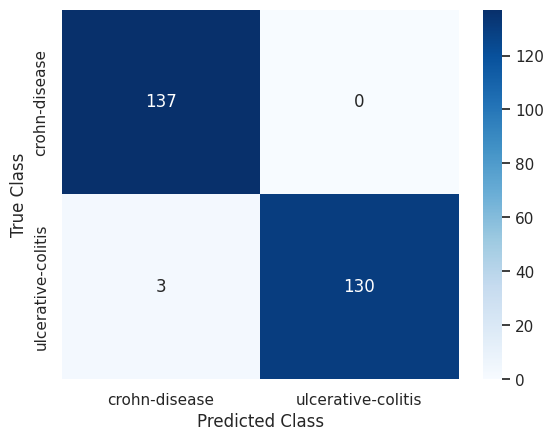

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

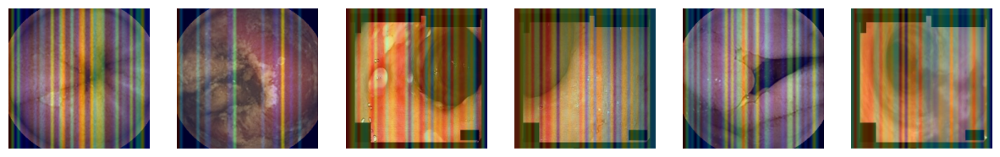

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s32.layers[-1].activation = None

  preds = model_vit_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

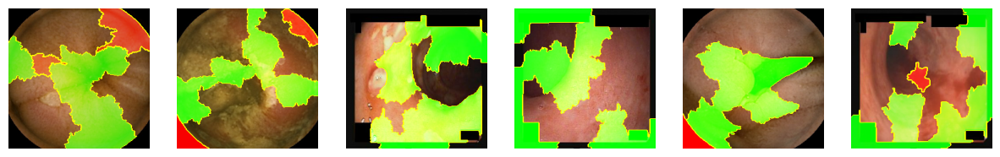

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


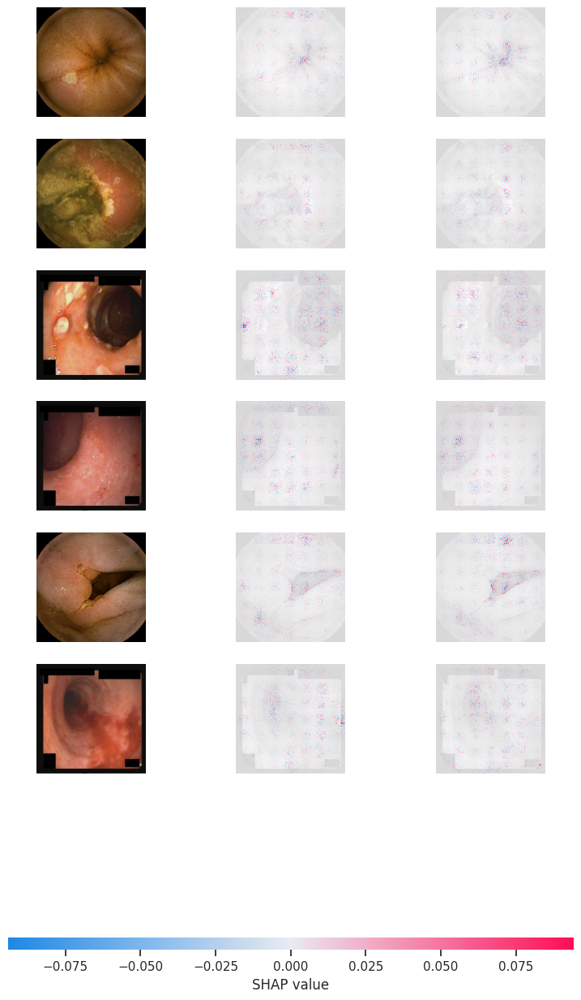

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s32, images_train_1).shap_values(image_interpretability_3)
shap.image_plot(shap_values, image_interpretability_3)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 262.93it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  7.17it/s]


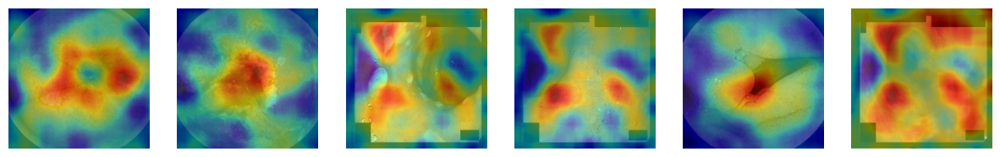

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

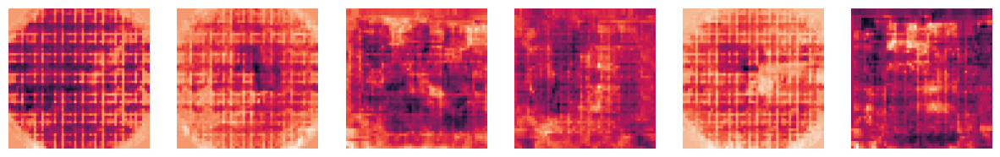

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_s32, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

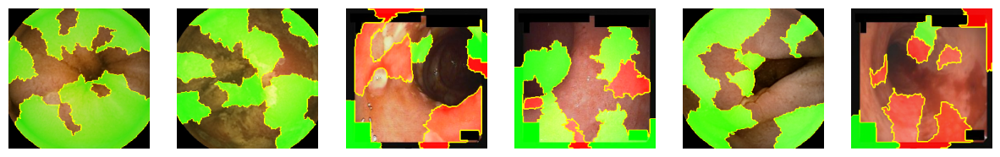

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 395.62it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.68it/s]


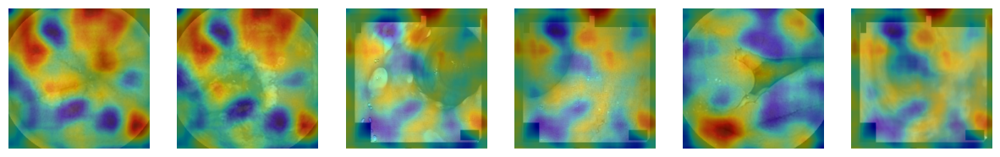

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

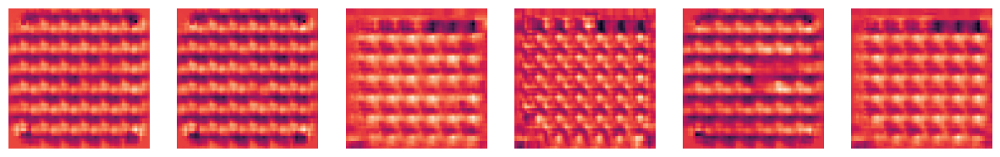

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

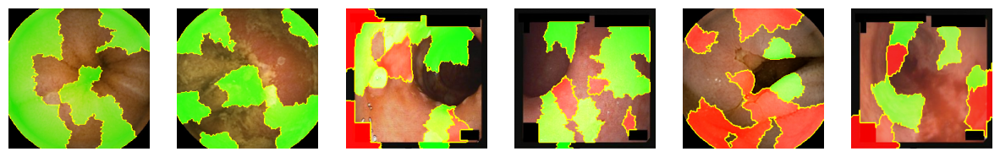

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 423.65it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.73it/s]


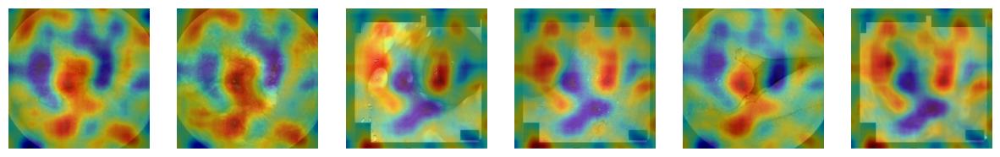

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Maps</h3>

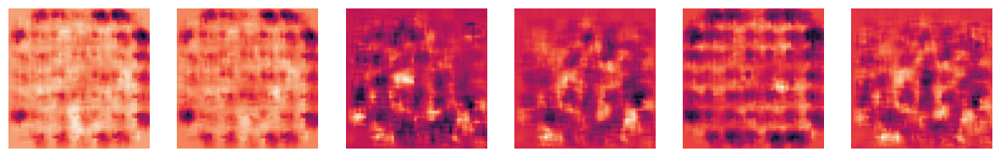

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_B/16

In [11]:
vit_model_16 = tfimm.create_model("vit_base_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_16_preprocessing = tfimm.create_preprocessing("vit_base_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_16_preprocessing(x)
x = vit_model_16.call(x)
x = layers.Dense(1000, activation="relu")(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_b16 = Model(inputs, outputs)

In [12]:
model_vit_b16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [13]:
model_vit_b16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [14]:
history_b16 = model_vit_b16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
26/26 [==============================] - 57s 2s/step - loss: 0.0407 - accuracy: 0.9828 - val_loss: 9.4789e-05 - val_accuracy: 1.0000
Epoch 2/200
26/26 [==============================] - 40s 2s/step - loss: 1.2522e-05 - accuracy: 1.0000 - val_loss: 1.5414e-04 - val_accuracy: 1.0000
Epoch 3/200
26/26 [==============================] - 41s 2s/step - loss: 8.4348e-06 - accuracy: 1.0000 - val_loss: 5.3282e-05 - val_accuracy: 1.0000
Epoch 4/200
26/26 [==============================] - 41s 2s/step - loss: 2.1266e-05 - accuracy: 1.0000 - val_loss: 1.1874e-04 - val_accuracy: 1.0000
Epoch 5/200
26/26 [==============================] - 41s 2s/step - loss: 5.7108e-06 - accuracy: 1.0000 - val_loss: 1.2636e-04 - val_accuracy: 1.0000
Epoch 6/200
26/26 [==============================] - 41s 2s/step - loss: 6.0731e-06 - accuracy: 1.0000 - val_loss: 9.5689e-05 - val_accuracy: 1.0000


<Axes: >

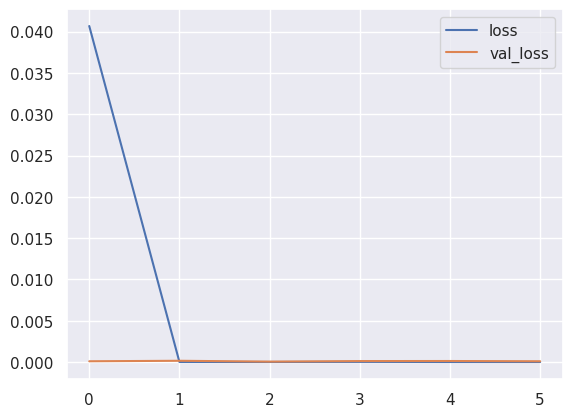

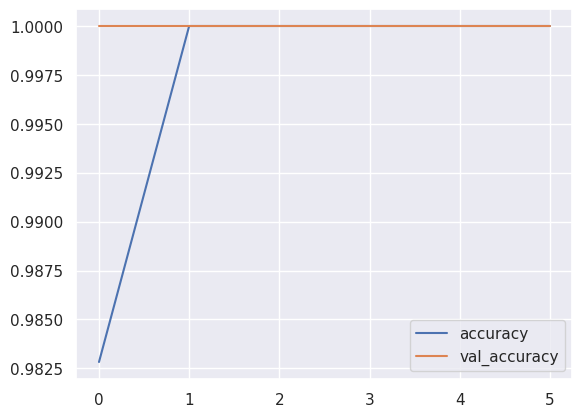

In [15]:
model_history_b16 = pd.DataFrame(history_b16.history)
model_history_b16.loc[:, ['loss', 'val_loss']].plot()
model_history_b16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [16]:
print('Accuracy for Train: {:.4f}'.format(model_history_b16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_b16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_b16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_b16['val_loss'].mean()))

Accuracy for Train: 0.9971
Loss for Train: 0.0068
Accuracy for Test: 1.0000
Loss for Test: 0.0001


In [17]:
start = time.time()
predict_labels_ = model_vit_b16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_b16 = np.argmax(model_vit_b16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_b16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_b16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_b16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_b16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_b16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_b16)))

Accuracy: 1.0000
Loss: 0.0001
Inference Time: 7.33s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


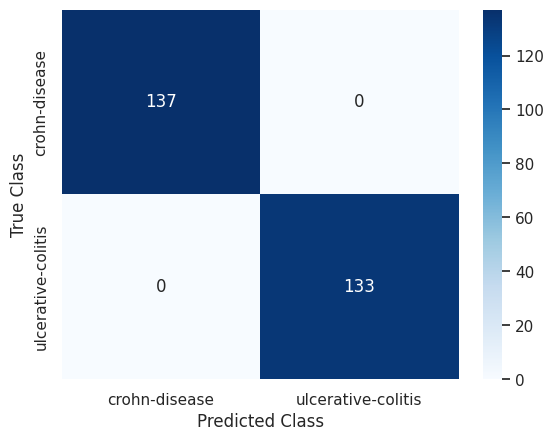

In [18]:
conf_matrix_b16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_b16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_b16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [19]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Knowledge Distillation</h1>

In [20]:
distillation_ViT = Distiller(student=student_model_2, teacher=model_vit_b16)

distillation_ViT.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [21]:
distillation_history_ViT = distillation_ViT.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
26/26 [==============================] - 22s 529ms/step - accuracy: 0.5632 - student_loss: 1.4106 - distillation_loss: 23.9593 - val_accuracy: 0.9816 - val_student_loss: 0.1497
Epoch 2/100
26/26 [==============================] - 15s 541ms/step - accuracy: 0.8675 - student_loss: 0.3204 - distillation_loss: 10.8965 - val_accuracy: 0.9871 - val_student_loss: 0.0030
Epoch 3/100
26/26 [==============================] - 14s 516ms/step - accuracy: 0.9571 - student_loss: 0.1826 - distillation_loss: 6.3535 - val_accuracy: 0.9669 - val_student_loss: 0.1854
Epoch 4/100
26/26 [==============================] - 14s 539ms/step - accuracy: 0.9656 - student_loss: 0.1656 - distillation_loss: 5.5234 - val_accuracy: 0.9871 - val_student_loss: 0.0062
Epoch 5/100
26/26 [==============================] - 13s 503ms/step - accuracy: 0.9742 - student_loss: 0.1266 - distillation_loss: 4.5584 - val_accuracy: 0.9871 - val_student_loss: 9.8719e-04
Epoch 6/100
26/26 [==============================] - 1

<Axes: >

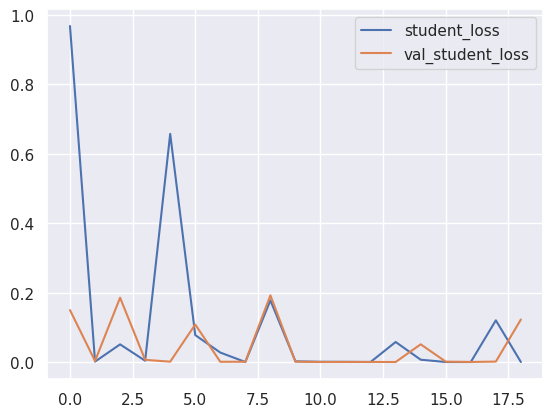

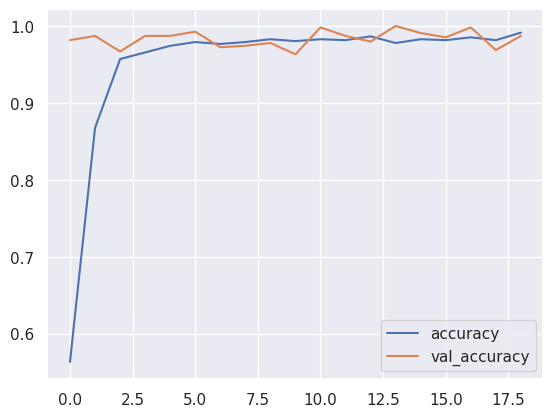

In [22]:
distiller_history = pd.DataFrame(distillation_history_ViT.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [23]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9514
Loss for Train: 0.1132
Accuracy for Test: 0.9835
Loss for Test: 0.0434


In [24]:
start_dist = time.time()
predict_labels_dist = distillation_ViT.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_ViT.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9889
Loss: 0.0240
Inference Time: 1.04s
Precision: 0.9779
Recall: 1.0000
F1-Score: 0.9888
AUC: 0.9891
MCC: 0.9780


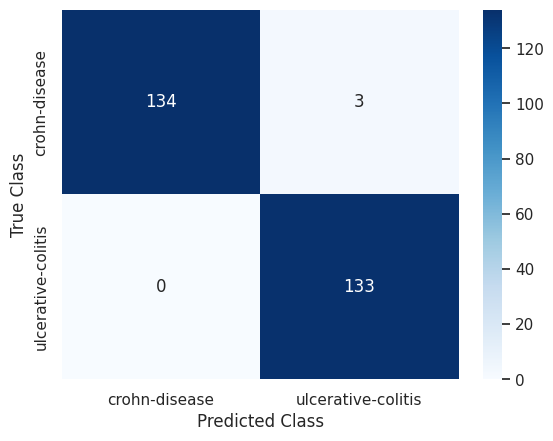

In [25]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [26]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_ViT.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [27]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [28]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [29]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
52/52 [==============================] - 50s 771ms/step - accuracy: 0.4558 - student_loss: 0.9822 - distillation_loss: 0.9047 - val_accuracy: 0.7941 - val_student_loss: 0.6689 - val_distillation_loss: 0.0000e+00
Epoch 2/100
52/52 [==============================] - 40s 765ms/step - accuracy: 0.5485 - student_loss: 0.8052 - distillation_loss: 0.7868 - val_accuracy: 0.8750 - val_student_loss: 0.5882 - val_distillation_loss: 0.0000e+00
Epoch 3/100
52/52 [==============================] - 39s 745ms/step - accuracy: 0.5914 - student_loss: 0.7289 - distillation_loss: 0.7000 - val_accuracy: 0.9062 - val_student_loss: 0.5115 - val_distillation_loss: 0.0000e+00
Epoch 4/100
52/52 [==============================] - 39s 756ms/step - accuracy: 0.7025 - student_loss: 0.6521 - distillation_loss: 0.6393 - val_accuracy: 0.9559 - val_student_loss: 0.4121 - val_distillation_loss: 0.0000e+00
Epoch 5/100
52/52 [==============================] - 39s 753ms/step - accuracy: 0.7779 - student_loss: 0

<Axes: >

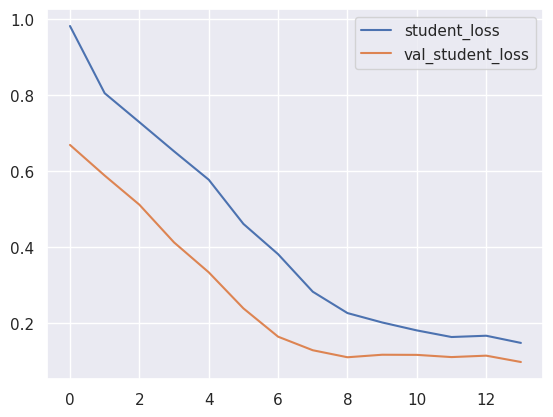

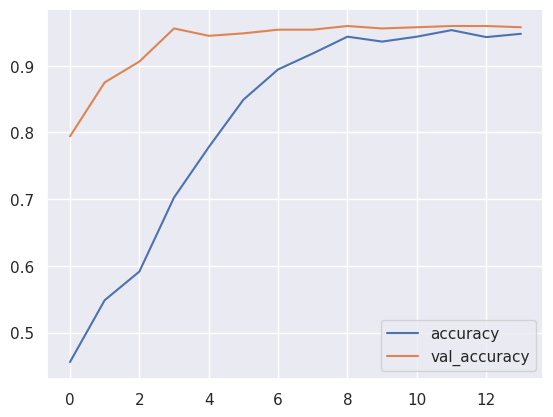

In [30]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [31]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8147
Loss for Train: 0.4252
Accuracy for Test: 0.9345
Loss for Test: 0.2647


In [32]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9704
Loss: 0.0831
Inference Time: 1.55s
Precision: 0.9630
Recall: 0.9774
F1-Score: 0.9701
AUC: 0.9705
MCC: 0.9408


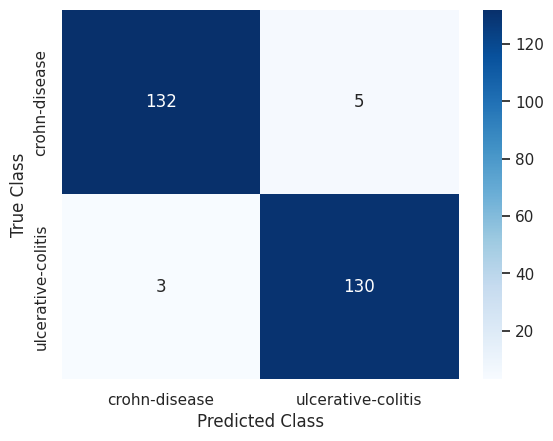

In [33]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [34]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

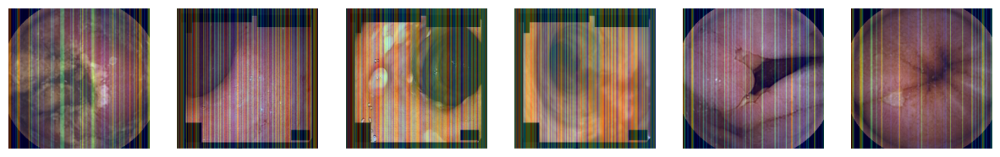

In [35]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3[:6], axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b16.layers[-1].activation = None

  preds = model_vit_b16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_b16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

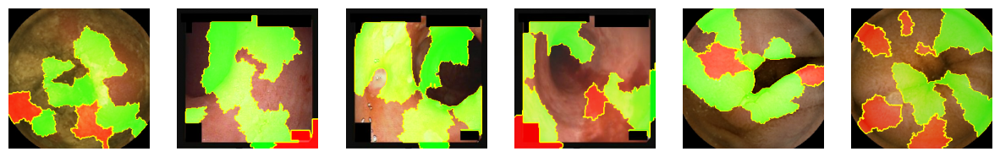

In [36]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


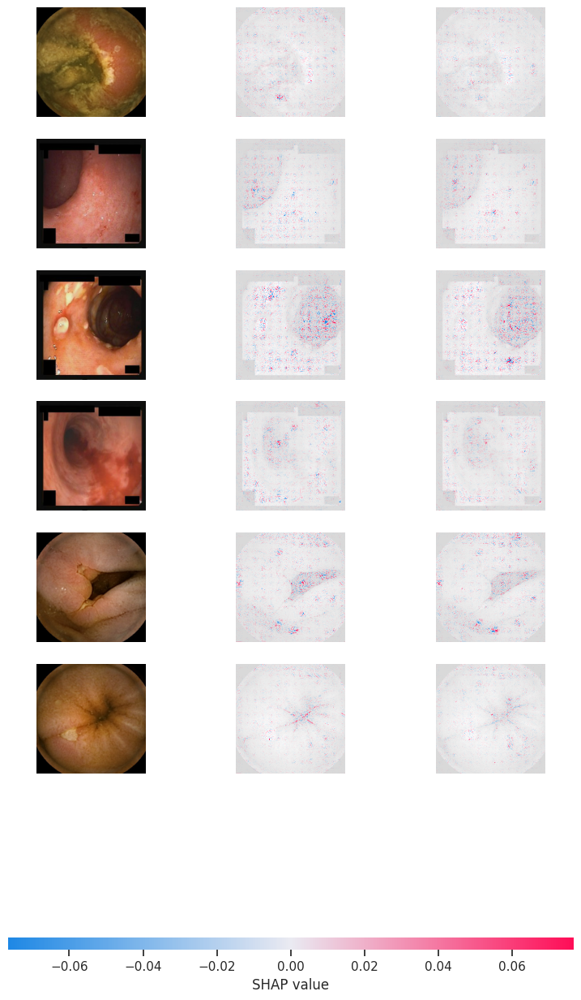

In [37]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b16, images_train_1).shap_values(image_interpretability_3)
shap.image_plot(shap_values, image_interpretability_3)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [38]:
model_rise = RISE(1000, 8, 0.5, model_vit_b16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 449.34it/s]


Explaining: 100%|██████████| 32/32 [00:18<00:00,  1.73it/s]


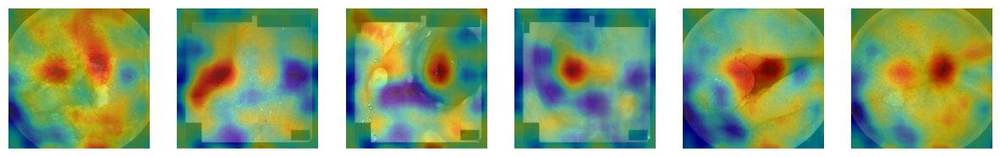

In [39]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

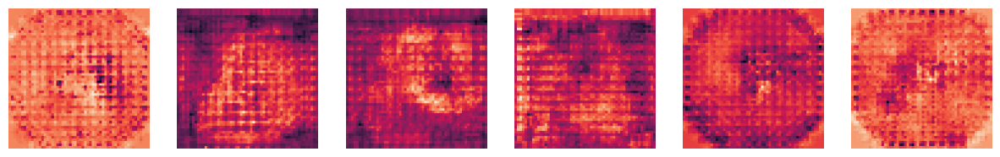

In [40]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_b16, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

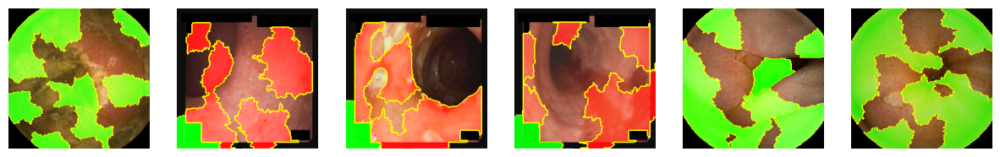

In [41]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [42]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 263.97it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.16it/s]


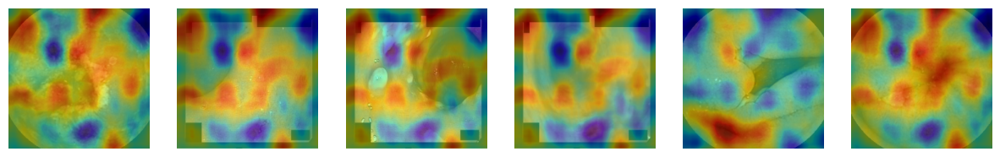

In [43]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

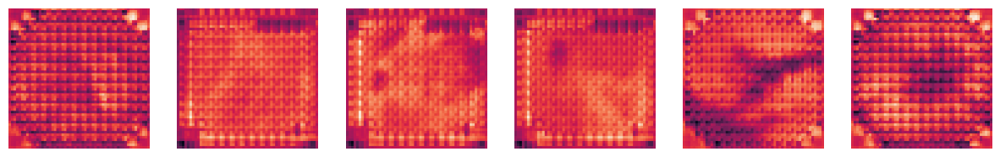

In [44]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

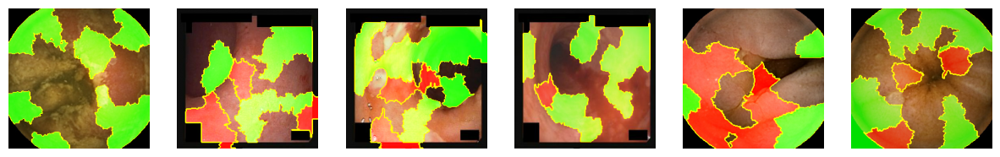

In [45]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1,6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_ViT.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [46]:
model_rise = RISE(1000, 8, 0.5, distillation_ViT, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:03<00:00, 305.05it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 13.89it/s]


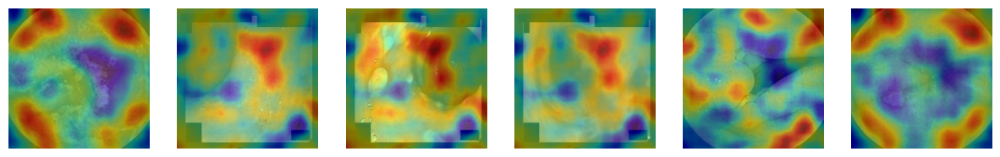

In [47]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivy</h3>

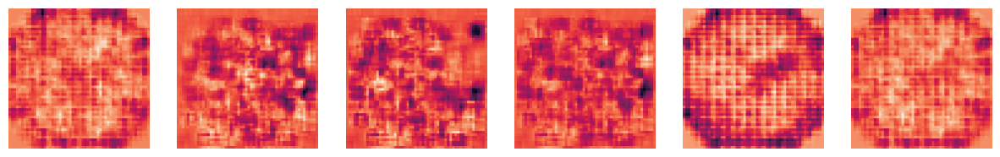

In [48]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_ViT, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/16

In [13]:
vit_model_s16 = tfimm.create_model("vit_small_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_s16_preprocessing = tfimm.create_preprocessing("vit_small_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s16_preprocessing(x)
x = vit_model_s16.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s16 = Model(inputs, outputs)

In [14]:
model_vit_s16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [15]:
model_vit_s16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [16]:
history_s16 = model_vit_s16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
26/26 [==============================] - 32s 674ms/step - loss: 0.2501 - accuracy: 0.9141 - val_loss: 0.0587 - val_accuracy: 0.9816
Epoch 2/200
26/26 [==============================] - 15s 567ms/step - loss: 0.0066 - accuracy: 0.9988 - val_loss: 0.0068 - val_accuracy: 1.0000
Epoch 3/200
26/26 [==============================] - 15s 573ms/step - loss: 3.1284e-04 - accuracy: 1.0000 - val_loss: 0.0037 - val_accuracy: 1.0000
Epoch 4/200
26/26 [==============================] - 15s 587ms/step - loss: 6.4728e-04 - accuracy: 1.0000 - val_loss: 0.0033 - val_accuracy: 1.0000
Epoch 5/200
26/26 [==============================] - 16s 593ms/step - loss: 2.7581e-04 - accuracy: 1.0000 - val_loss: 0.0024 - val_accuracy: 1.0000
Epoch 6/200
26/26 [==============================] - 16s 595ms/step - loss: 1.4141e-04 - accuracy: 1.0000 - val_loss: 0.0021 - val_accuracy: 1.0000
Epoch 7/200
26/26 [==============================] - 15s 588ms/step - loss: 1.4440e-04 - accuracy: 1.0000 - val_loss: 0.

<Axes: >

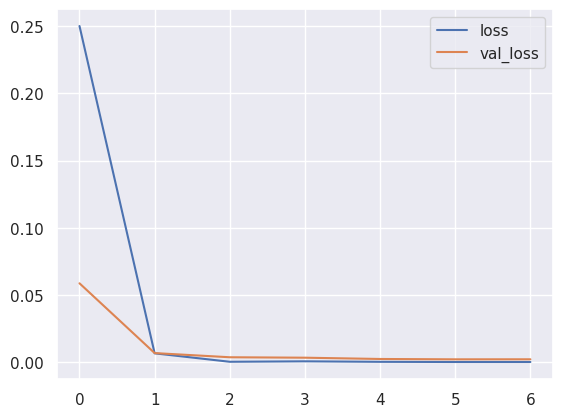

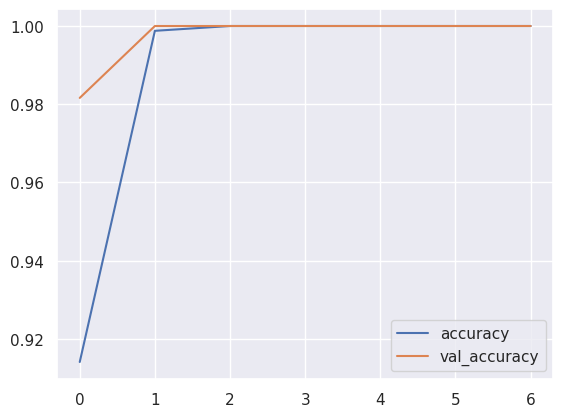

In [17]:
model_history_s16 = pd.DataFrame(history_s16.history)
model_history_s16.loc[:, ['loss', 'val_loss']].plot()
model_history_s16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [18]:
print('Accuracy for Train: {:.4f}'.format(model_history_s16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s16['val_loss'].mean()))

Accuracy for Train: 0.9876
Loss for Train: 0.0369
Accuracy for Test: 0.9974
Loss for Test: 0.0113


In [19]:
start = time.time()
predict_labels_ = model_vit_s16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s16 = np.argmax(model_vit_s16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s16)))

Accuracy: 1.0000
Loss: 0.0021
Inference Time: 3.64s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


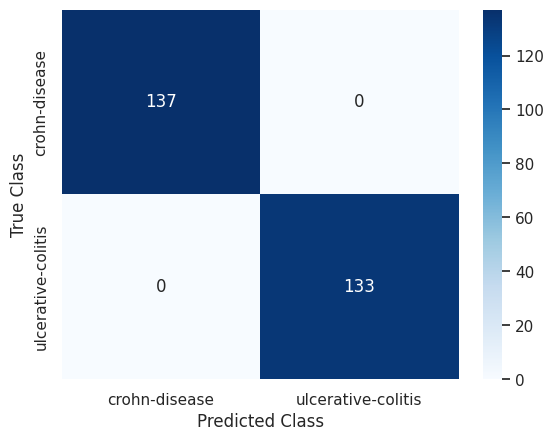

In [20]:
conf_matrix_s16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [21]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [22]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s16)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [23]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
26/26 [==============================] - 17s 299ms/step - accuracy: 0.6540 - student_loss: 0.9926 - distillation_loss: 9.8805 - val_accuracy: 0.9926 - val_student_loss: 0.0249
Epoch 2/100
26/26 [==============================] - 6s 232ms/step - accuracy: 0.9227 - student_loss: 0.2624 - distillation_loss: 4.2799 - val_accuracy: 0.9945 - val_student_loss: 0.0262
Epoch 3/100
26/26 [==============================] - 7s 268ms/step - accuracy: 0.9571 - student_loss: 0.1354 - distillation_loss: 3.1560 - val_accuracy: 0.9908 - val_student_loss: 0.0206
Epoch 4/100
26/26 [==============================] - 7s 240ms/step - accuracy: 0.9693 - student_loss: 0.0968 - distillation_loss: 2.8885 - val_accuracy: 0.9963 - val_student_loss: 0.0051
Epoch 5/100
26/26 [==============================] - 6s 233ms/step - accuracy: 0.9583 - student_loss: 0.1286 - distillation_loss: 2.9574 - val_accuracy: 0.9982 - val_student_loss: 0.0062
Epoch 6/100
26/26 [==============================] - 7s 234ms/st

<Axes: >

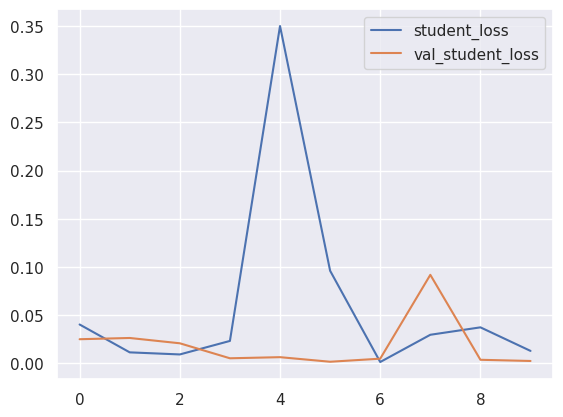

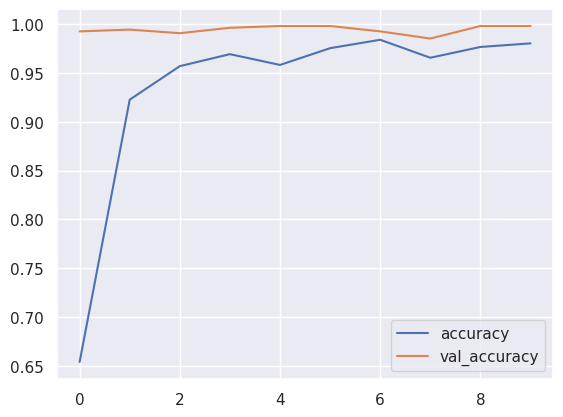

In [24]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [25]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9344
Loss for Train: 0.0610
Accuracy for Test: 0.9945
Loss for Test: 0.0187


In [26]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 1.0000
Loss: 0.0046
Inference Time: 1.70s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


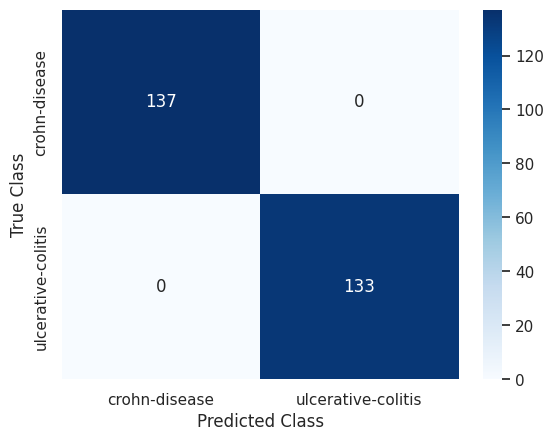

In [28]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [29]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [30]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [31]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [32]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
52/52 [==============================] - 44s 516ms/step - accuracy: 0.4509 - student_loss: 0.9656 - distillation_loss: 0.9712 - val_accuracy: 0.4945 - val_student_loss: 0.7114 - val_distillation_loss: 0.0000e+00
Epoch 2/100
52/52 [==============================] - 26s 499ms/step - accuracy: 0.5546 - student_loss: 0.7954 - distillation_loss: 0.7485 - val_accuracy: 0.9026 - val_student_loss: 0.5753 - val_distillation_loss: 0.0000e+00
Epoch 3/100
52/52 [==============================] - 26s 499ms/step - accuracy: 0.6675 - student_loss: 0.6725 - distillation_loss: 0.6651 - val_accuracy: 0.9357 - val_student_loss: 0.4413 - val_distillation_loss: 0.0000e+00
Epoch 4/100
52/52 [==============================] - 25s 485ms/step - accuracy: 0.7681 - student_loss: 0.5505 - distillation_loss: 0.5573 - val_accuracy: 0.9320 - val_student_loss: 0.3120 - val_distillation_loss: 0.0000e+00
Epoch 5/100
52/52 [==============================] - 26s 502ms/step - accuracy: 0.8595 - student_loss: 0

<Axes: >

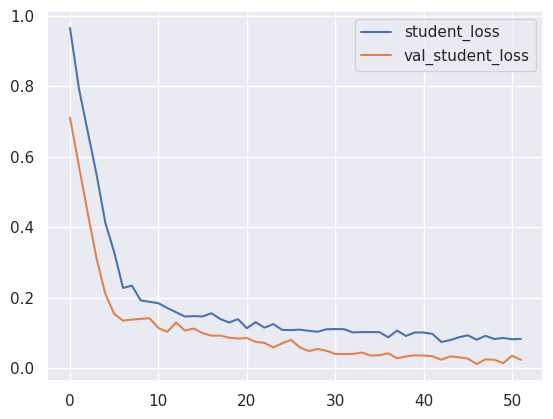

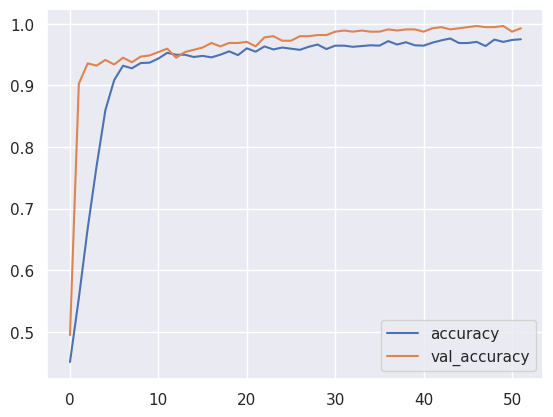

In [33]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [34]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9296
Loss for Train: 0.1784
Accuracy for Test: 0.9631
Loss for Test: 0.1025


In [35]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9926
Loss: 0.0216
Inference Time: 1.27s
Precision: 0.9925
Recall: 0.9925
F1-Score: 0.9925
AUC: 0.9926
MCC: 0.9852


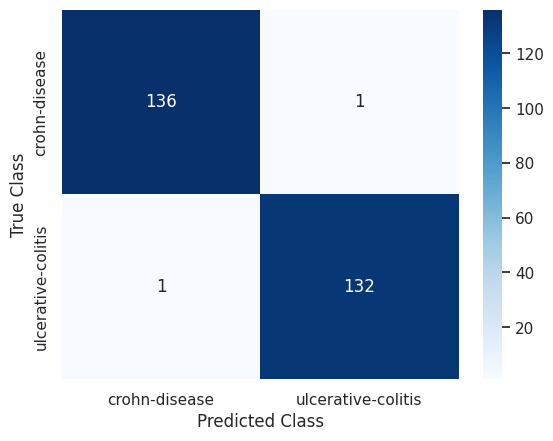

In [36]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [37]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

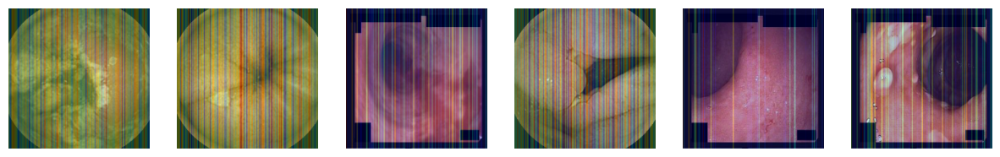

In [38]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s16.layers[-1].activation = None

  preds = model_vit_s16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

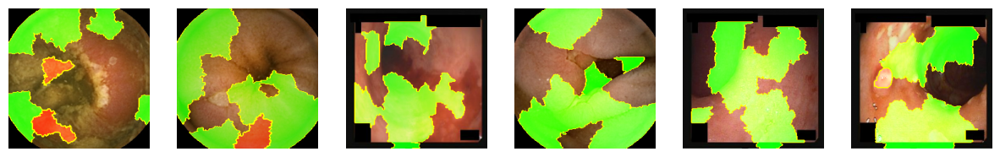

In [39]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


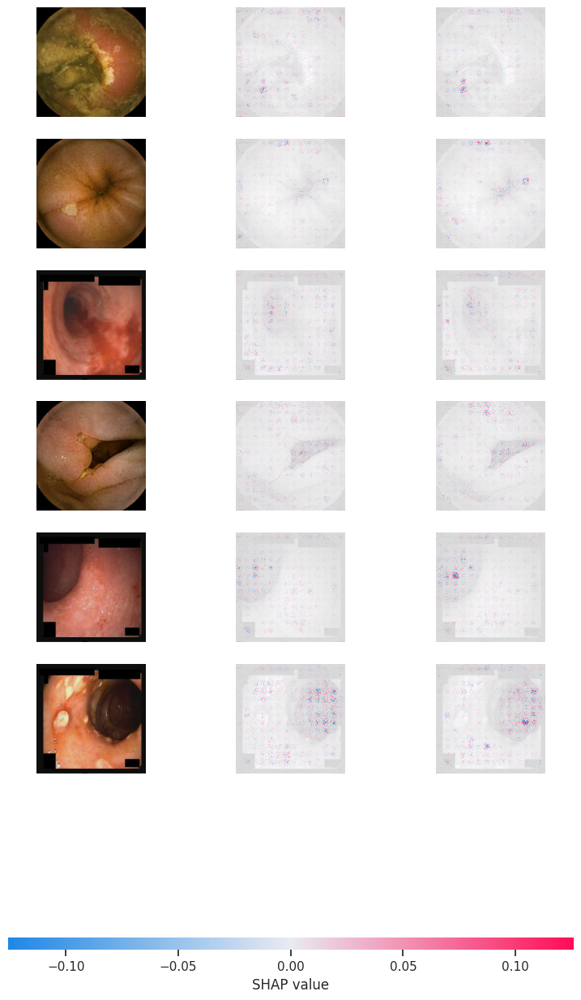

In [40]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s16, images_train_1).shap_values(image_interpretability_3)
shap.image_plot(shap_values, image_interpretability_3)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [41]:
model_rise = RISE(1000, 8, 0.5, model_vit_s16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 389.64it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s]


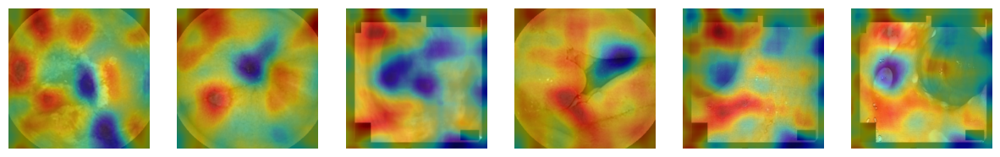

In [42]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

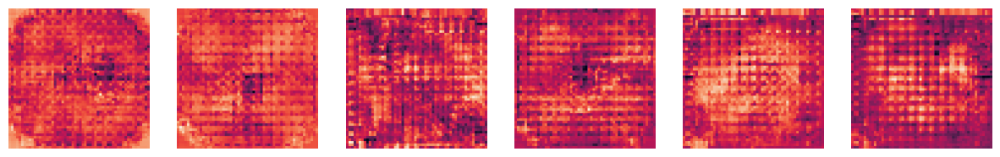

In [43]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_s16, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

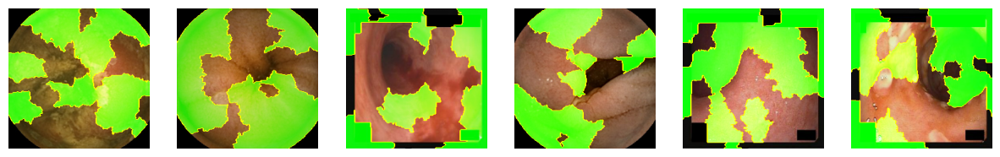

In [44]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [45]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 429.71it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  9.35it/s]


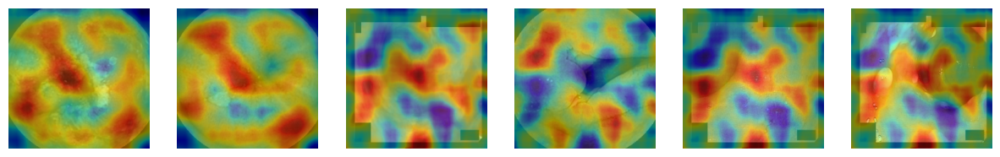

In [46]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

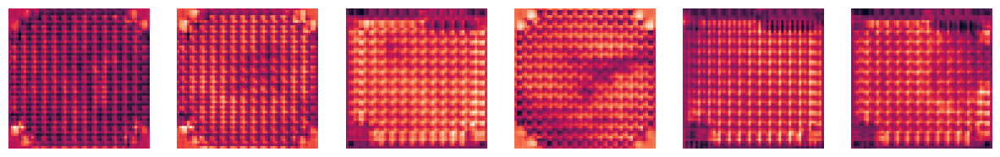

In [47]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

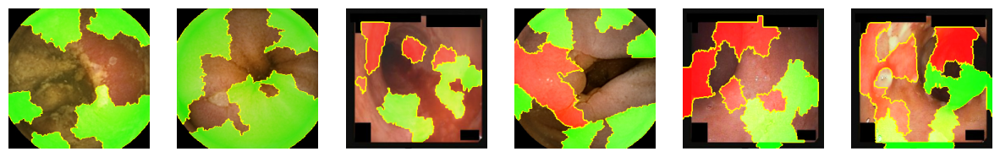

In [48]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [49]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 426.38it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 13.99it/s]


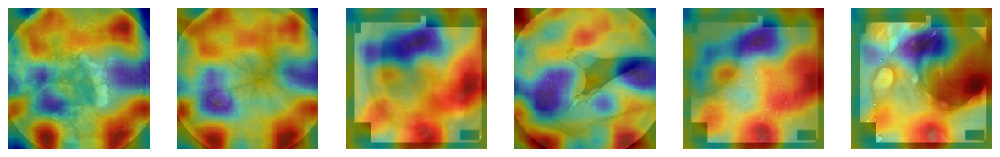

In [50]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

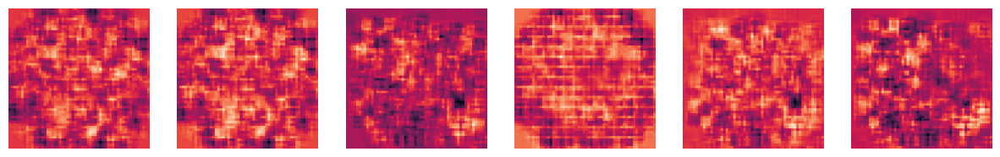

In [51]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# R26+S/32

In [ ]:
vit_model_hybrid_s32 = tfimm.create_model("vit_small_r26_s32_224_in21k", pretrained=True, nb_classes=0)
vit_model_hybrid_s32_preprocessing = tfimm.create_preprocessing("vit_small_r26_s32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_hybrid_s32_preprocessing(x)
x = vit_model_hybrid_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_hybrid_s32 = Model(inputs, outputs)

In [ ]:
model_vit_hybrid_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_hybrid_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_hybrid_s32 = model_vit_hybrid_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
26/26 [==============================] - 52s 943ms/step - loss: 0.0722 - accuracy: 0.9693 - val_loss: 0.0066 - val_accuracy: 1.0000
Epoch 2/200
26/26 [==============================] - 18s 688ms/step - loss: 4.1010e-04 - accuracy: 1.0000 - val_loss: 0.0023 - val_accuracy: 1.0000
Epoch 3/200
26/26 [==============================] - 18s 682ms/step - loss: 2.8929e-04 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 4/200
26/26 [==============================] - 19s 704ms/step - loss: 2.6661e-04 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 5/200
26/26 [==============================] - 18s 696ms/step - loss: 2.3876e-04 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 6/200
26/26 [==============================] - 18s 698ms/step - loss: 2.2464e-04 - accuracy: 1.0000 - val_loss: 0.0017 - val_accuracy: 1.0000


<Axes: >

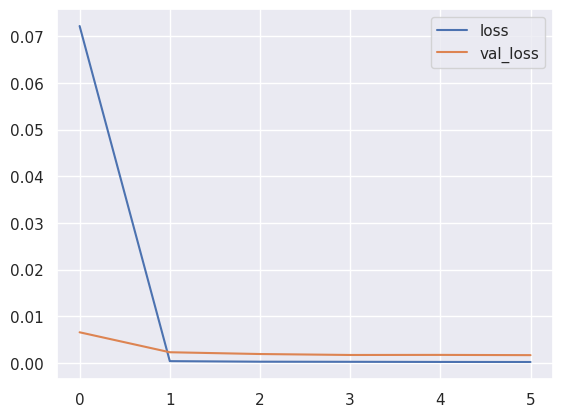

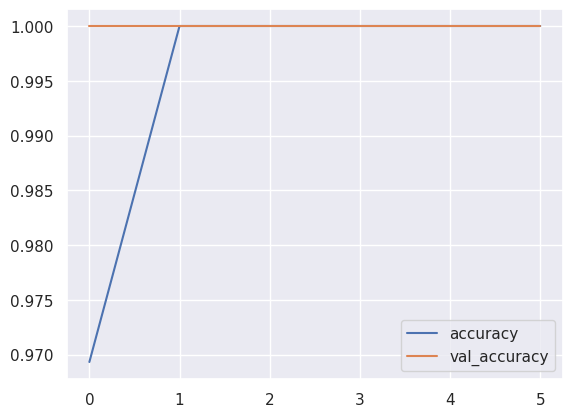

In [ ]:
model_history_hybrid_s32 = pd.DataFrame(history_hybrid_s32.history)
model_history_hybrid_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_hybrid_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_hybrid_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_hybrid_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_hybrid_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_hybrid_s32['val_loss'].mean()))

Accuracy for Train: 0.9949
Loss for Train: 0.0123
Accuracy for Test: 1.0000
Loss for Test: 0.0027


In [ ]:
start = time.time()
predict_labels_ = model_vit_hybrid_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_hybrid_s32 = np.argmax(model_vit_hybrid_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_hybrid_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_hybrid_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_hybrid_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_hybrid_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_hybrid_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_hybrid_s32)))

Accuracy: 1.0000
Loss: 0.0029
Inference Time: 6.76s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


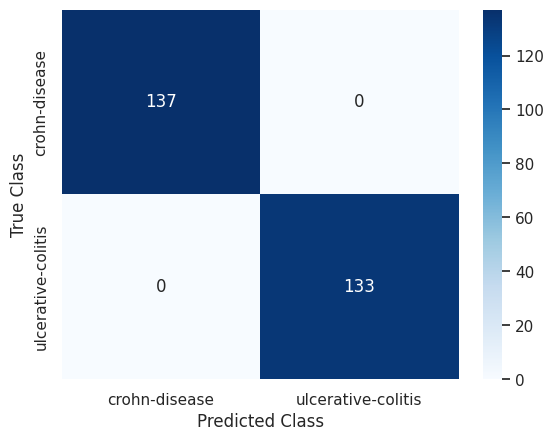

In [ ]:
conf_matrix_hybrid_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_hybrid_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_hybrid_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_hybrid_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_hybrid_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
26/26 [==============================] - 21s 328ms/step - accuracy: 0.5374 - student_loss: 1.1548 - distillation_loss: 14.7176 - val_accuracy: 0.7022 - val_student_loss: 0.5276
Epoch 2/100
26/26 [==============================] - 7s 258ms/step - accuracy: 0.7080 - student_loss: 0.7913 - distillation_loss: 11.4388 - val_accuracy: 0.9669 - val_student_loss: 0.0558
Epoch 3/100
26/26 [==============================] - 8s 281ms/step - accuracy: 0.9104 - student_loss: 0.3088 - distillation_loss: 5.2852 - val_accuracy: 0.9412 - val_student_loss: 0.5562
Epoch 4/100
26/26 [==============================] - 7s 260ms/step - accuracy: 0.9288 - student_loss: 0.2606 - distillation_loss: 4.4229 - val_accuracy: 0.9577 - val_student_loss: 0.3024
Epoch 5/100
26/26 [==============================] - 8s 269ms/step - accuracy: 0.9423 - student_loss: 0.2217 - distillation_loss: 4.1769 - val_accuracy: 0.9706 - val_student_loss: 0.0049
Epoch 6/100
26/26 [==============================] - 8s 309ms/

<Axes: >

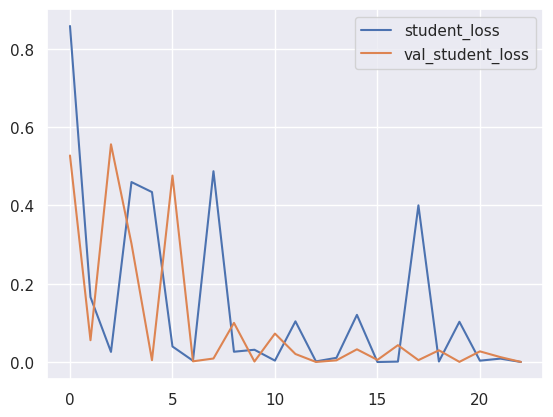

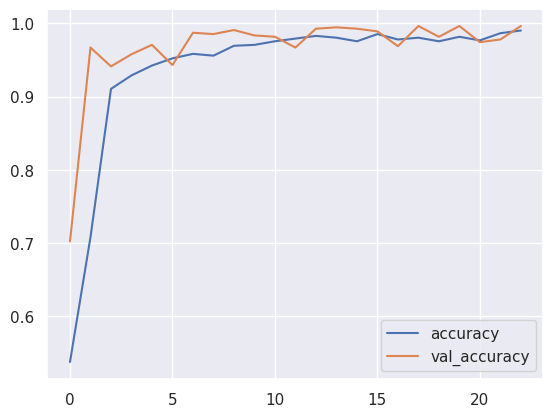

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9383
Loss for Train: 0.1431
Accuracy for Test: 0.9668
Loss for Test: 0.0996


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9963
Loss: 0.0064
Inference Time: 1.55s
Precision: 0.9925
Recall: 1.0000
F1-Score: 0.9963
AUC: 0.9964
MCC: 0.9926


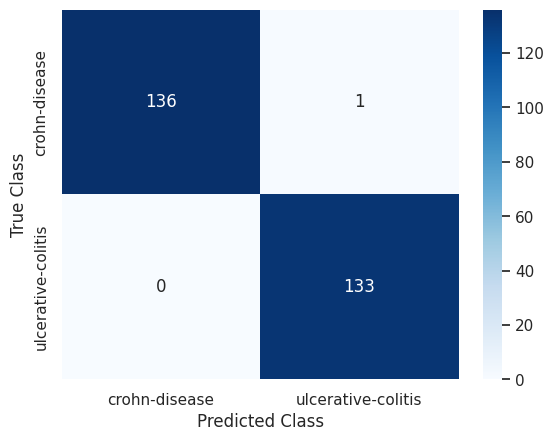

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_hybrid_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
52/52 [==============================] - 47s 490ms/step - accuracy: 0.6405 - student_loss: 0.7404 - distillation_loss: 0.6962 - val_accuracy: 0.9081 - val_student_loss: 0.4179 - val_distillation_loss: 0.0000e+00
Epoch 2/100
52/52 [==============================] - 23s 440ms/step - accuracy: 0.8012 - student_loss: 0.5104 - distillation_loss: 0.5279 - val_accuracy: 0.9430 - val_student_loss: 0.2374 - val_distillation_loss: 0.0000e+00
Epoch 3/100
52/52 [==============================] - 24s 448ms/step - accuracy: 0.8920 - student_loss: 0.3301 - distillation_loss: 0.3734 - val_accuracy: 0.9246 - val_student_loss: 0.1945 - val_distillation_loss: 0.0000e+00
Epoch 4/100
52/52 [==============================] - 23s 445ms/step - accuracy: 0.9239 - student_loss: 0.2487 - distillation_loss: 0.2632 - val_accuracy: 0.9375 - val_student_loss: 0.1374 - val_distillation_loss: 0.0000e+00
Epoch 5/100
52/52 [==============================] - 25s 486ms/step - accuracy: 0.9301 - student_loss: 0

<Axes: >

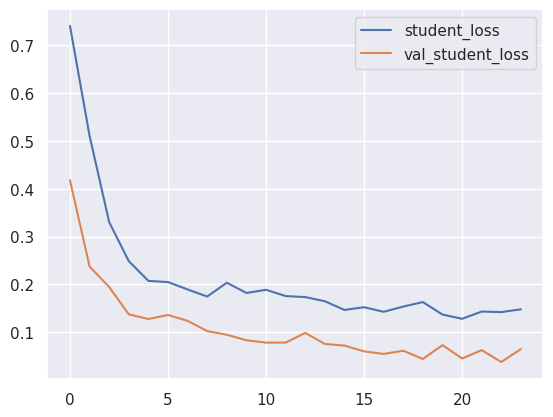

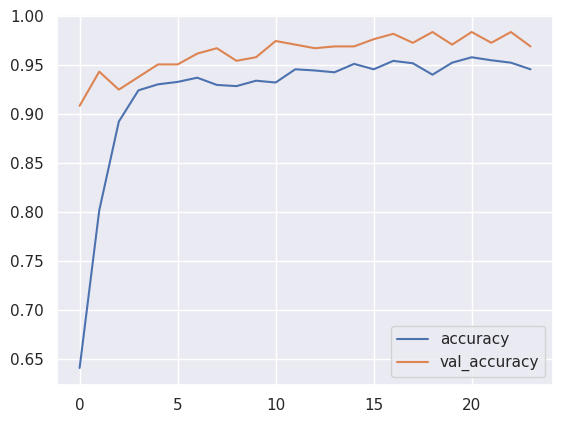

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9215
Loss for Train: 0.2147
Accuracy for Test: 0.9623
Loss for Test: 0.1068


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9889
Loss: 0.0376
Inference Time: 1.08s
Precision: 1.0000
Recall: 0.9774
F1-Score: 0.9886
AUC: 0.9887
MCC: 0.9780


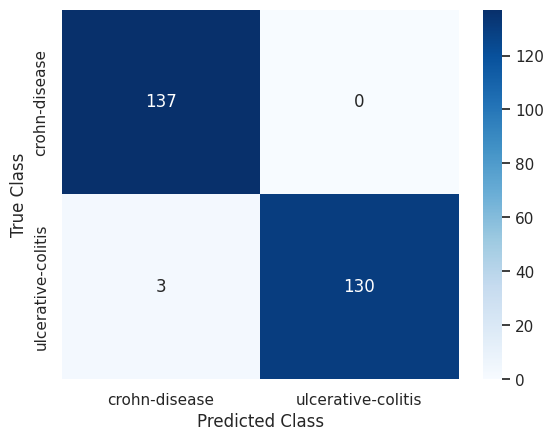

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

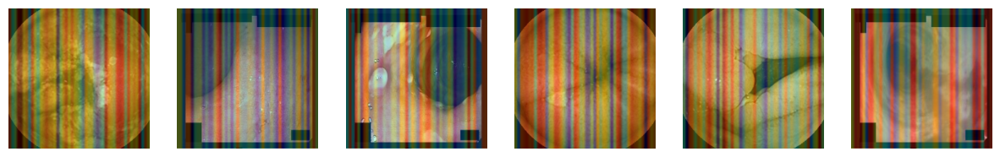

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_hybrid_s32.layers[-1].activation = None

  preds = model_vit_hybrid_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_hybrid_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

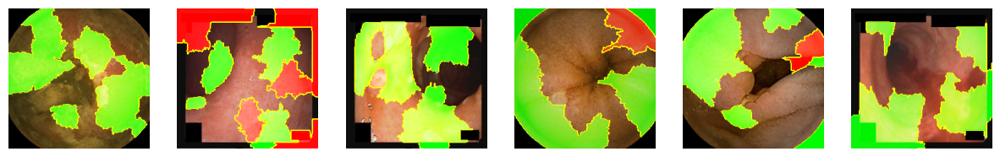

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_hybrid_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


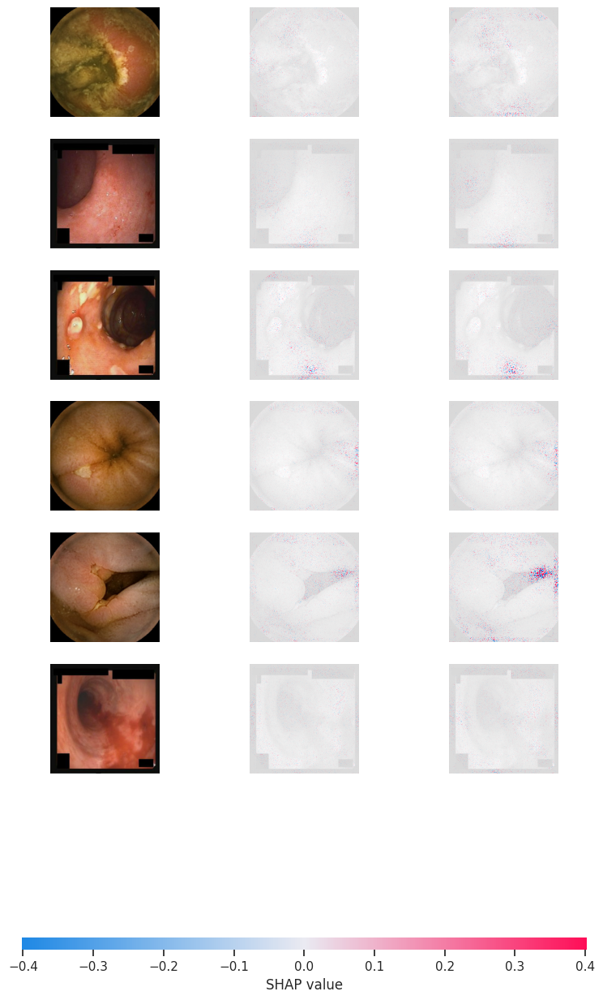

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_hybrid_s32, images_train_1).shap_values(image_interpretability_3)
shap.image_plot(shap_values, image_interpretability_3)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_hybrid_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 379.67it/s]


Explaining: 100%|██████████| 32/32 [00:09<00:00,  3.24it/s]


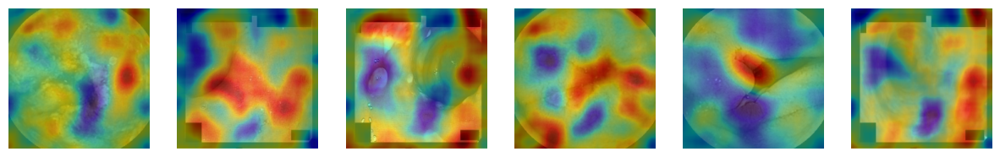

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

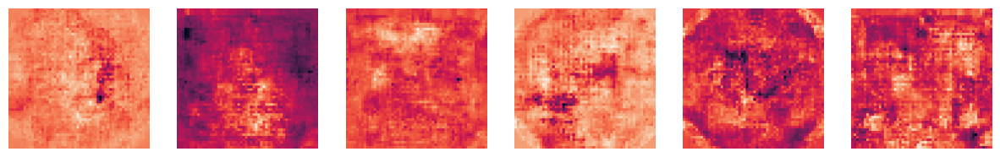

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_hybrid_s32, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

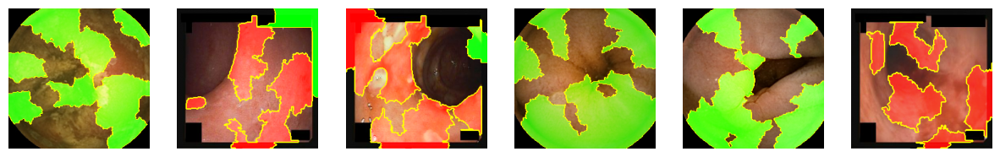

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 374.68it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00,  8.65it/s]


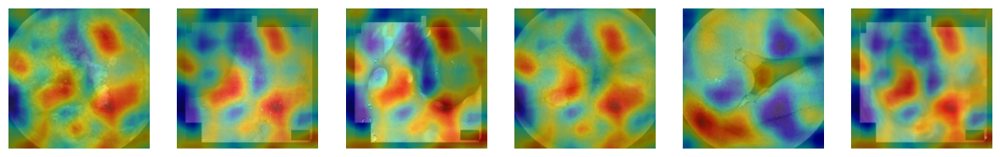

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

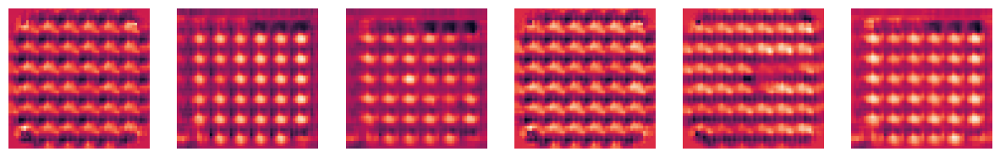

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

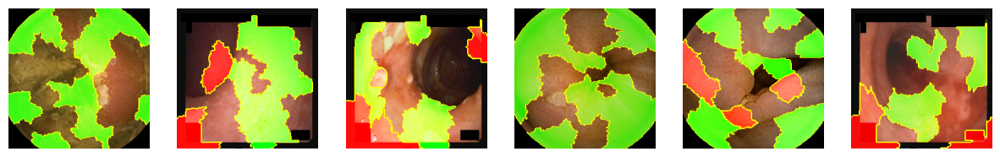

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 435.97it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.89it/s]


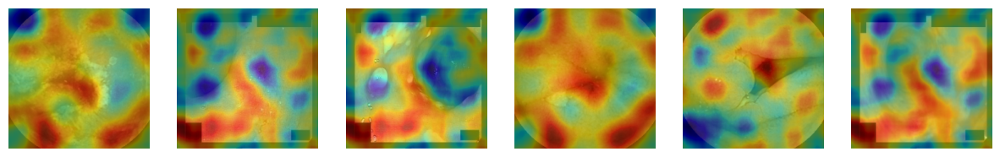

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_3[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

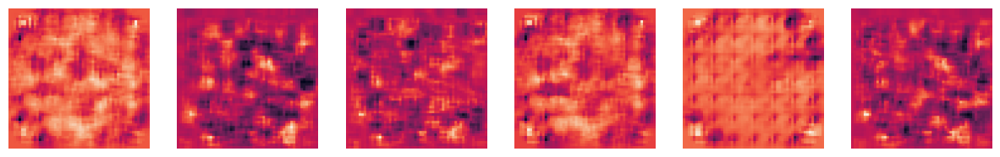

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_3, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_3[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1